In [24]:
#import click
import pathlib

import numpy as np
import pandas as pd

#from classifiers import *
import matplotlib.pyplot as plt

import os
import math
import itertools
from sklearn.model_selection import StratifiedKFold
import seaborn as sns

In [2]:
def group_df_analyte(df, data_column="data"):
    df = df.pivot_table(
        values=data_column,
        # index=["sampleID_metadata", "panel_detail", "panel", "serostatus_delta_IgG"],
        index=["sampleID_metadata", "panel_detail", "panel"],
        columns=["analyte"],
        aggfunc="first",
        dropna=True,
    )

    df = df.dropna()

    df = df.reset_index(level=["panel_detail"])

    return df

In [3]:
def preprocess_data(
    df_in,
    antibody="IgG",
    sero_th="all",
    data_column="data",
    exclude_features=("None"),
):
    """
    Antibody: "IgG", "IgM", "IgM_IgG"
    sero_th: "all", "positive", "borderline positive"
    data_column: "data", "dataln"
    panel: "all", "acute", "epi"
    exclude_features: list of features we would like to exclude for example ["M1", "L1R"]
    """

    # Replace -inf with NaN
    df_in.replace([np.inf, -np.inf], np.nan, inplace=True)

    # Fow now filter antibody values
    if antibody == "IgM_IgG":
        # Filter out IgA or other analytes
        df_in = df_in[df_in["isotype"].isin(["IgM", "IgG"])]
        df_in["analyte"] = df_in["isotype"] + "_" + df_in["analyte"]
    else:
        df_in = df_in[df_in["isotype"] == antibody]
        df_in["analyte"] = df_in["isotype"] + "_" + df_in["analyte"]
    
    # Only select necessary columns, for now Analyte(s)
    df_in = df_in[
        [
            "sampleID_metadata",
            "panel_detail",
            "panel",
            "analyte",
            data_column,
            "serostatus_cat.delta",
        ]
    ]

    # Add column for explicit serostatus of delta antigen
    df_in["serostatus_delta_IgG"] = df_in.apply(lambda x: x['serostatus_cat.delta'] if x["analyte"] == "IgG_Delta" else np.nan, axis=1)
    serostatus_IDs = df_in[df_in["serostatus_delta_IgG"].notna()]

    if sero_th == "positive":
        serostatus_IDs = serostatus_IDs[serostatus_IDs["serostatus_delta_IgG"].isin(["positive"])]
    elif sero_th == "borderline positive":
        serostatus_IDs = serostatus_IDs[
            serostatus_IDs["serostatus_delta_IgG"].isin(["borderline positive", "positive"])
        ]
    serostatus_IDs = serostatus_IDs["sampleID_metadata"].unique()



    print(
        f"ATTENTION: Dataframe includes {df_in.panel_detail.isna().sum()} rows with NaN values in panel_detail.\
        These will be excluded from further analysis."
    )

    # Drop NaN
    df_in = df_in[df_in["panel_detail"].notna()]

    # Group by patient ID so that we have analytes as columns
    df_out = group_df_analyte(df_in, data_column=data_column)

    # Drop column if in exclude_features
    # need to use endswith so it will work with IgM+IgG data
    # where columns look like this "IgM_M1", "IgG_M1", ..
    cols_to_drop = df_out.columns[df_out.columns.str.endswith(exclude_features)]
    df_out = df_out.drop(cols_to_drop, axis=1, errors="ignore")

    # Convert multi-index to columns
    df_out = df_out.reset_index()
    

    # Filter only for the serostatus of delta IgG
    if not sero_th == "all":
        df_out = df_out[df_out['sampleID_metadata'].isin(serostatus_IDs)]

    # Reset index
    df_out = df_out.set_index(["sampleID_metadata"])


    # drop this again
    # df_out = df_out.drop("serostatus_delta_IgG", axis=1)

    # Remove CPXV for now
    df_out = df_out[df_out["panel_detail"] != "CPXV"]

    # Extract the unknown samples as df_spox
    df_spox = df_out[df_out["panel_detail"] == "SPox"].drop(["panel"], axis=1)
    # extract the repetition panel
    df_rep = df_out[df_out["panel_detail"] == "SPox_Rep"].drop(["panel"], axis=1)
    # Add -rep to ID
    df_rep = df_rep.rename(index=lambda s: s + '-rep')
    # concat them both
    df_spox = pd.concat([df_spox, df_rep])

    
    # Replace Pre_New samples with Pre
    df_out.loc[df_out.panel_detail == "Pre_New", 'panel_detail'] = "Pre"

    # Remove the Spox and Spox_Rep columns
    df_out = df_out[df_out["panel_detail"] != "SPox"]
    df_out = df_out[df_out["panel_detail"] != "SPox_Rep"]
    
    # Split to the three panels and drop the panel column, not needed anymore
    df_all = df_out.drop(["panel"], axis=1)
    df_acute = df_out[df_out["panel"] != "SPox"].drop(["panel"], axis=1)
    df_epi = df_out[df_out["panel"] == "SPox"].drop(["panel"], axis=1)

    return df_all, df_acute, df_epi, df_spox

def set_split(df_train, df_test, seed, n_split=5):
    # If identical we use train test split
    if df_train.columns.name  == df_test.columns.name :
        X = df_train.iloc[:, 1:]
        y = df_train.iloc[:, 0]
        # dataset split depends on n_split and current seed 
        # for performing repeated k-fold 
        kfold_seed = math.floor(seed / n_split)
        skfold = StratifiedKFold(n_splits=n_split, shuffle=True, random_state=kfold_seed)

        # because we choose our seeds from 70 to 80
        k = seed % n_split
        train_idx, test_idx = list(skfold.split(X,y))[k]

        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]

        
    # Otherwise we use complete dataset
    else:
        # Make sure there is no overlap, remove any potential overlap
        df_train = df_train.reset_index()
        df_test = df_test.reset_index()
        cond = df_train['sampleID_metadata'].isin(df_test['sampleID_metadata'])
        df_train = df_train.drop(df_train[cond].index)
        df_train = df_train.set_index('sampleID_metadata')
        df_test = df_test.set_index('sampleID_metadata')


        X_train = df_train.iloc[:, 1:]
        y_train = df_train.iloc[:, 0]
        X_test = df_test.iloc[:, 1:]
        y_test = df_test.iloc[:, 0]
        
    cont = None
    if not set(y_train.unique()) == set(y_test.unique()):
        cont = True
        
    return X_train, y_train, X_test, y_test, cont

In [4]:
input_data = pd.read_csv("../dataInputAll.csv") # Change path if necessary

/local/job_3698894/ipykernel_2572617/2125827941.py:1: DtypeWarning: Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.
  input_data = pd.read_csv("../dataInputAll.csv") # Change path if necessary


In [5]:
antibody_list = ["IgM_IgG", "IgG"]
sero_list = ["all"]
data_cols_list = [ "dataIn"]
exclusion_list = [("L1R", "M1", "VACV")] 
# k for k-fold cross validation
n_split = 5
# How often we want to repeat k-fold cross validation 
reps = 3
seed_runs = reps*n_split
start_seed = 70

In [6]:
d = {}
for antibody, sero_status, data_col, exclude_cols in itertools.product(
    antibody_list, sero_list, data_cols_list, exclusion_list
):
    df_all, df_acute, df_epi, df_spox = preprocess_data(
        input_data,
        antibody=antibody,
        sero_th=sero_status,
        data_column=data_col,
        exclude_features=exclude_cols,
    )
    # just for readability when saving files
    exclude_cols = "".join(exclude_cols)
    d[
        f"antibody_{antibody}_serostatus_{sero_status}_datacol_{data_col}_excluding_{exclude_cols}"
    ] = [df_all, df_acute, df_epi, df_spox]

/local/job_3698894/ipykernel_2572617/3132985836.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in["analyte"] = df_in["isotype"] + "_" + df_in["analyte"]


ATTENTION: Dataframe includes 0 rows with NaN values in panel_detail.        These will be excluded from further analysis.
ATTENTION: Dataframe includes 0 rows with NaN values in panel_detail.        These will be excluded from further analysis.


/local/job_3698894/ipykernel_2572617/3132985836.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in["analyte"] = df_in["isotype"] + "_" + df_in["analyte"]


In [7]:
df_all, df_acute, df_epi, df_spox = d['antibody_IgG_serostatus_all_datacol_dataIn_excluding_L1RM1VACV']

In [8]:
df_all

analyte,panel_detail,IgG_A27L,IgG_A29,IgG_A33R,IgG_A35R,IgG_A5L,IgG_ATI-C,IgG_ATI-N,IgG_B5R,IgG_B6,IgG_D8L,IgG_Delta,IgG_E8,IgG_H3L
sampleID_metadata,,,,,,,,,,,,,,
MMR-01,Pre,2.795496,2.354499,3.365944,3.536482,3.286727,2.673188,1.506057,3.058845,3.286580,2.466263,2.483216,3.058715,2.758277
MMR-02,Pre,2.420116,1.603806,1.775962,1.409434,4.215493,3.164249,2.410631,1.341146,0.878499,1.742839,0.000000,1.298874,2.316689
MMR-03,Pre,2.686218,3.081066,1.312229,1.405882,2.847560,3.722014,1.643252,2.306598,1.852291,1.841935,0.000000,1.337812,2.468610
MMR-04,Pre,2.674464,2.102391,1.796029,1.530188,3.354736,3.268285,3.058083,1.358402,1.162979,1.984837,0.000000,1.503326,2.450876
MMR-05,Pre,1.987318,1.813178,1.847028,1.485907,2.960016,3.251413,1.541054,1.185838,0.951761,2.096542,0.000000,2.592221,2.740041
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SPox-1111,MPXV,3.409737,2.772428,3.149088,3.737815,3.631957,3.665658,2.443050,3.193725,3.526359,3.160345,2.649427,3.317210,3.384528
SPox-1113,MVA,2.607055,2.326063,2.690789,2.338684,3.498552,3.295507,2.005552,2.114584,2.034781,2.634701,1.966658,2.721599,3.139896
SPox-1114,MVA,2.463715,1.823380,2.767424,2.056116,4.228172,3.175009,1.825335,2.140603,2.076917,2.913421,1.892422,2.895101,2.627757


In [9]:
df_acute

analyte,panel_detail,IgG_A27L,IgG_A29,IgG_A33R,IgG_A35R,IgG_A5L,IgG_ATI-C,IgG_ATI-N,IgG_B5R,IgG_B6,IgG_D8L,IgG_Delta,IgG_E8,IgG_H3L
sampleID_metadata,,,,,,,,,,,,,,
MMR-01,Pre,2.795496,2.354499,3.365944,3.536482,3.286727,2.673188,1.506057,3.058845,3.286580,2.466263,2.483216,3.058715,2.758277
MMR-02,Pre,2.420116,1.603806,1.775962,1.409434,4.215493,3.164249,2.410631,1.341146,0.878499,1.742839,0.000000,1.298874,2.316689
MMR-03,Pre,2.686218,3.081066,1.312229,1.405882,2.847560,3.722014,1.643252,2.306598,1.852291,1.841935,0.000000,1.337812,2.468610
MMR-04,Pre,2.674464,2.102391,1.796029,1.530188,3.354736,3.268285,3.058083,1.358402,1.162979,1.984837,0.000000,1.503326,2.450876
MMR-05,Pre,1.987318,1.813178,1.847028,1.485907,2.960016,3.251413,1.541054,1.185838,0.951761,2.096542,0.000000,2.592221,2.740041
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S-20-004-026-01,Pre,3.174743,2.334080,2.259939,1.914257,3.960502,3.901381,1.657356,1.348243,0.999225,2.029349,1.300198,1.552349,2.811648
S-20-004-026-02,MVA,3.151743,2.758053,2.461842,2.213412,3.936587,3.840432,1.824147,2.055972,1.938735,2.715570,1.699702,2.438785,2.808652
S-20-004-027-01,Pre,3.209226,2.256235,1.840834,1.799198,3.805542,3.453967,1.903392,1.730481,1.267089,2.154740,1.177512,1.634023,2.670798


In [10]:
df_epi

analyte,panel_detail,IgG_A27L,IgG_A29,IgG_A33R,IgG_A35R,IgG_A5L,IgG_ATI-C,IgG_ATI-N,IgG_B5R,IgG_B6,IgG_D8L,IgG_Delta,IgG_E8,IgG_H3L
sampleID_metadata,,,,,,,,,,,,,,
SPox-0001,Pre,2.532462,2.314795,2.113980,2.060448,3.470221,3.778034,1.484787,1.447667,1.344786,2.154402,0.000000,1.148526,2.481406
SPox-0002,MVA,2.459287,2.480773,1.856349,1.859443,4.135006,4.096808,1.820162,2.487694,2.306223,2.195123,1.260315,3.049224,2.710760
SPox-0003,Pre,2.335298,2.081578,1.588380,1.558493,3.225092,3.419466,1.417819,1.717465,1.494252,1.884398,0.283378,1.417972,2.335391
SPox-0004,MVA,2.513475,1.891702,2.433850,2.431137,3.617336,3.216154,2.209161,1.908783,1.708401,2.727381,1.817104,2.629169,3.224360
SPox-0005,MVA,2.211981,1.894980,3.326292,3.360383,3.354907,4.058075,2.253215,3.170224,3.004890,3.412737,2.638815,3.634024,3.337912
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SPox-1111,MPXV,3.409737,2.772428,3.149088,3.737815,3.631957,3.665658,2.443050,3.193725,3.526359,3.160345,2.649427,3.317210,3.384528
SPox-1113,MVA,2.607055,2.326063,2.690789,2.338684,3.498552,3.295507,2.005552,2.114584,2.034781,2.634701,1.966658,2.721599,3.139896
SPox-1114,MVA,2.463715,1.823380,2.767424,2.056116,4.228172,3.175009,1.825335,2.140603,2.076917,2.913421,1.892422,2.895101,2.627757


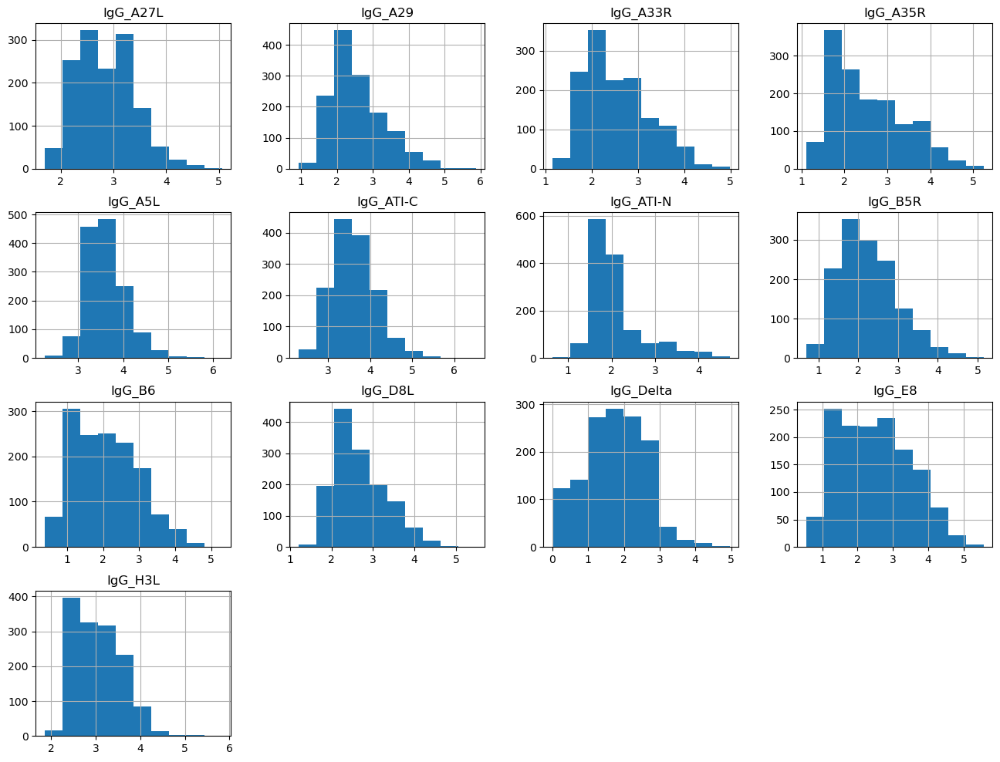

In [11]:
# Visulize some proberties of the df_igg_table
df_all.hist(figsize=(16, 12));


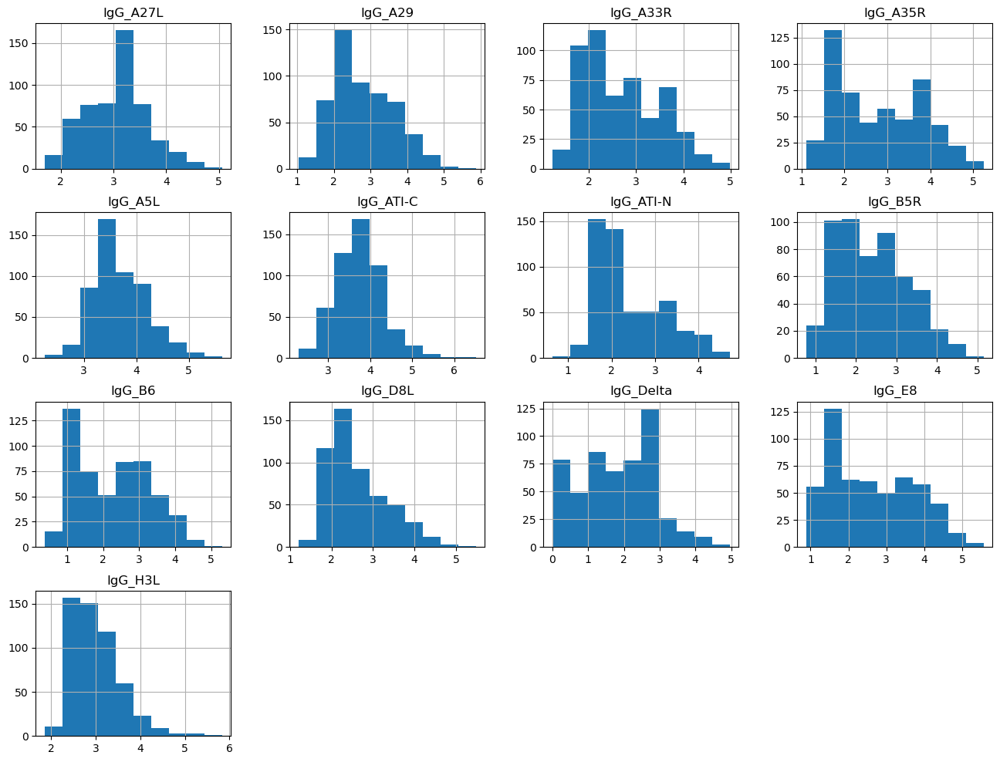

In [12]:
df_acute.hist(figsize=(16, 12));

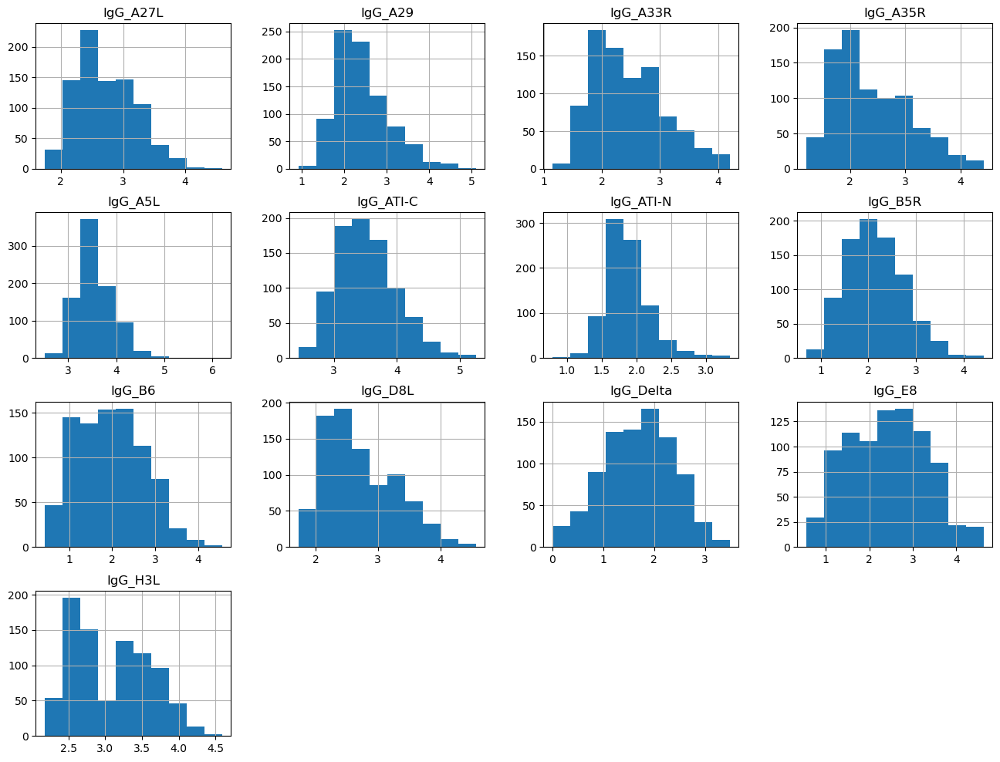

In [13]:
df_epi.hist(figsize=(16, 12));

NameError: name 'plt' is not defined

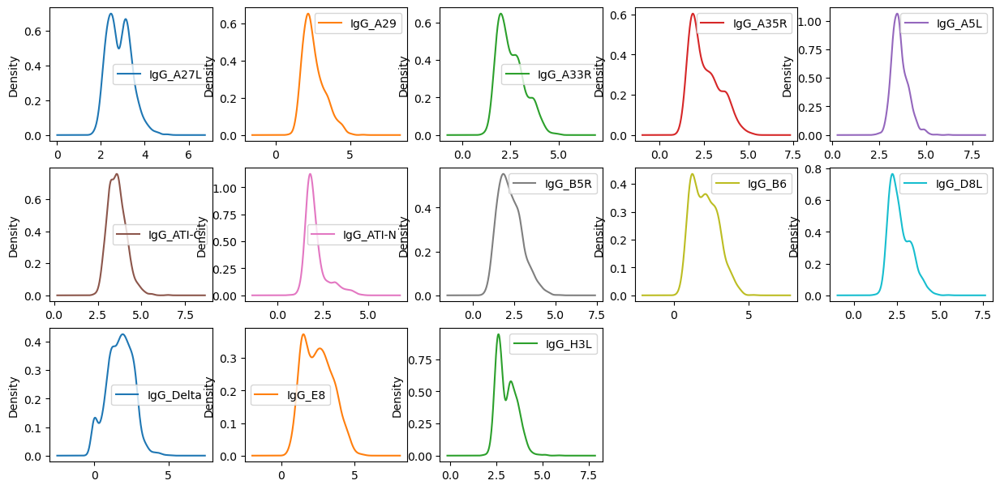

In [14]:
df_all.plot(kind="density", layout=(6,5), 
             subplots=True,sharex=False, sharey=False, figsize=(15,15))
plt.show()

In [ ]:
df_acute.plot(kind="density", layout=(6,5), 
             subplots=True,sharex=False, sharey=False, figsize=(15,15))
plt.show()

NameError: name 'plt' is not defined

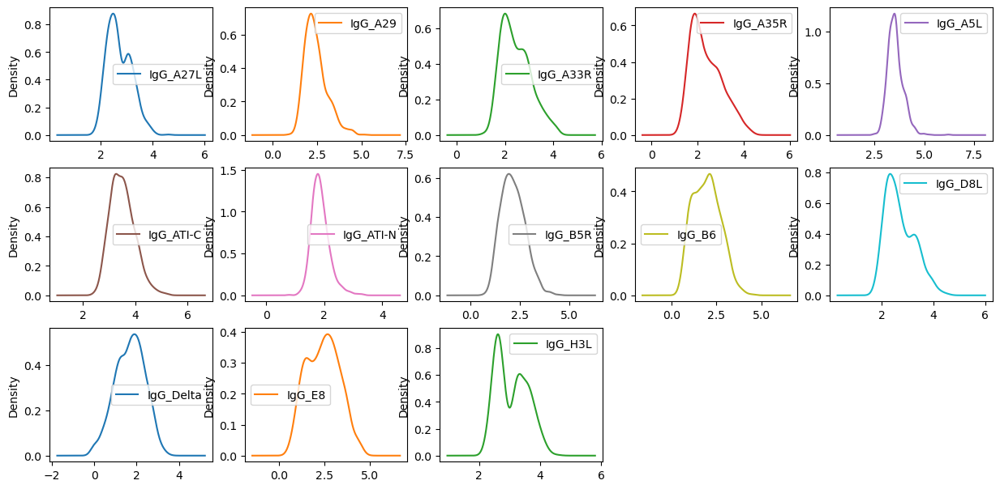

In [15]:
df_epi.plot(kind="density", layout=(6,5), 
             subplots=True,sharex=False, sharey=False, figsize=(15,15))
plt.show()

In [16]:
df_all.describe().T

,count,mean,std,min,25%,50%,75%,max
analyte,,,,,,,,
IgG_A27L,1395.0,2.850370,0.542863,1.693402,2.416575,2.813617,3.227875,5.059643
IgG_A29,1395.0,2.568005,0.730814,0.926730,2.042722,2.401647,2.998953,5.875116
IgG_A33R,1395.0,2.550767,0.700092,1.146051,1.983128,2.403917,2.990014,4.984580
IgG_A35R,1395.0,2.548224,0.839046,1.107530,1.864712,2.338684,3.125952,5.244706
IgG_A5L,1395.0,3.609492,0.442541,2.251696,3.305178,3.542237,3.863579,6.199647
IgG_ATI-C,1395.0,3.605738,0.520956,2.294120,3.228440,3.563493,3.924917,6.513826
IgG_ATI-N,1395.0,2.072516,0.605095,0.640852,1.696702,1.896825,2.206391,4.717248
IgG_B5R,1395.0,2.247162,0.724925,0.690784,1.696440,2.142921,2.720053,5.154036
IgG_B6,1395.0,2.071508,0.876529,0.367308,1.320784,2.012806,2.713393,5.308799


In [17]:
df_acute.describe().T

,count,mean,std,min,25%,50%,75%,max
analyte,,,,,,,,
IgG_A27L,536.0,3.062420,0.587453,1.693402,2.600118,3.117265,3.395164,5.059643
IgG_A29,536.0,2.804177,0.819331,1.040134,2.171807,2.675901,3.409061,5.875116
IgG_A33R,536.0,2.696069,0.802078,1.230027,2.012682,2.538546,3.297857,4.984580
IgG_A35R,536.0,2.803131,0.995352,1.107530,1.893572,2.670557,3.700950,5.244706
IgG_A5L,536.0,3.686471,0.514390,2.251696,3.324061,3.583957,4.009705,5.637730
IgG_ATI-C,536.0,3.749498,0.572131,2.294120,3.336365,3.709770,4.096255,6.513826
IgG_ATI-N,536.0,2.399811,0.786175,0.640852,1.797728,2.125814,3.000987,4.717248
IgG_B5R,536.0,2.411661,0.865328,0.769472,1.700322,2.309030,2.974270,5.154036
IgG_B6,536.0,2.255287,1.012757,0.367308,1.295228,2.217598,3.016375,5.308799


In [18]:
df_epi.describe().T

,count,mean,std,min,25%,50%,75%,max
analyte,,,,,,,,
IgG_A27L,859.0,2.718055,0.466903,1.739926,2.347190,2.627474,3.060845,4.591016
IgG_A29,859.0,2.420639,0.626552,0.926730,1.977005,2.292874,2.734871,5.098603
IgG_A33R,859.0,2.460101,0.611355,1.146051,1.970063,2.357153,2.884814,4.202674
IgG_A35R,859.0,2.389166,0.678315,1.206665,1.849585,2.242924,2.854489,4.415088
IgG_A5L,859.0,3.561459,0.383650,2.515922,3.300092,3.523913,3.771644,6.199647
IgG_ATI-C,859.0,3.516034,0.464613,2.436797,3.174842,3.477060,3.799814,5.255081
IgG_ATI-N,859.0,1.868290,0.317488,0.791486,1.653335,1.824465,2.030304,3.340309
IgG_B5R,859.0,2.144518,0.599545,0.690784,1.695212,2.088211,2.537445,4.423672
IgG_B6,859.0,1.956834,0.757926,0.430466,1.344460,1.956709,2.494332,4.551206


AttributeError: module 'matplotlib' has no attribute 'show'

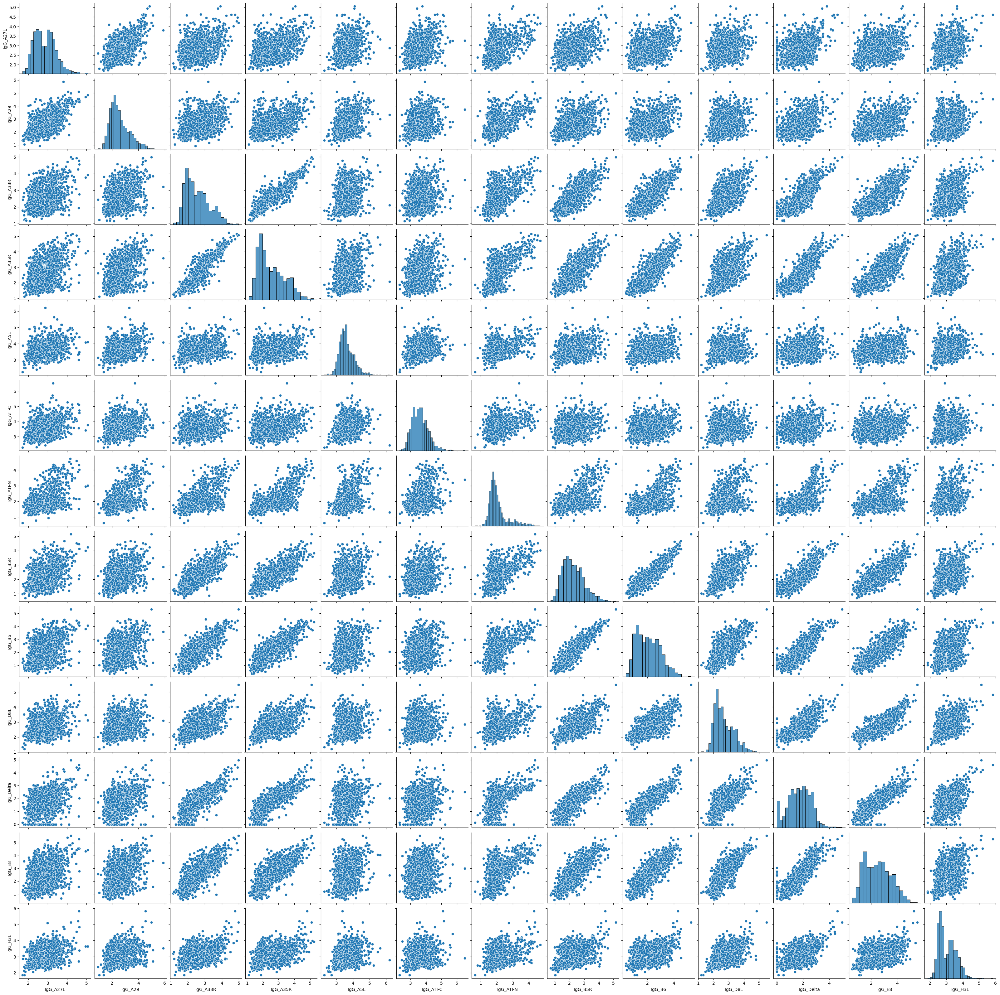

In [23]:
# This will take some time (3-5min)
import warnings
warnings.filterwarnings('ignore')
sns.pairplot(df_all)
plt.show()

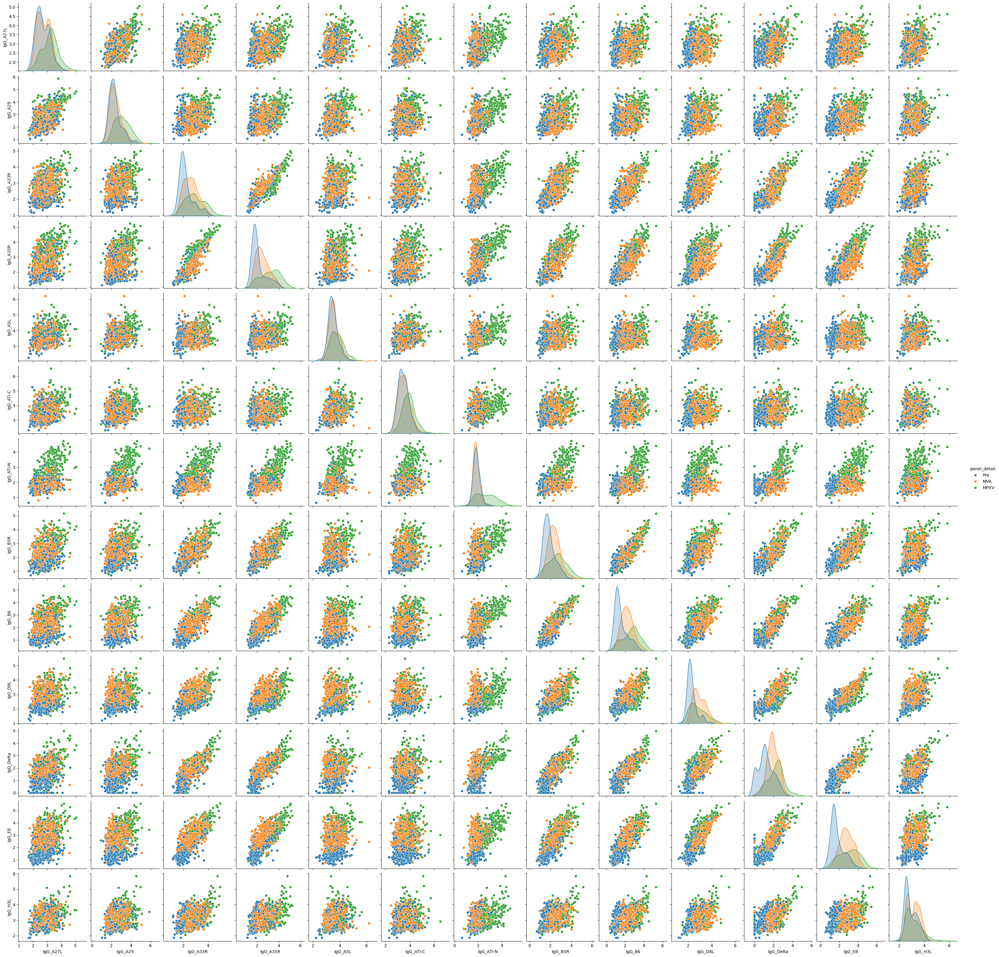

In [25]:
import warnings
warnings.filterwarnings('ignore')
#df_corr = df_igg_all.drop("panel", axis=1)
sns.pairplot(df_all, hue='panel_detail', hue_order=["Pre", "MVA", "MPXV"])
plt.show()

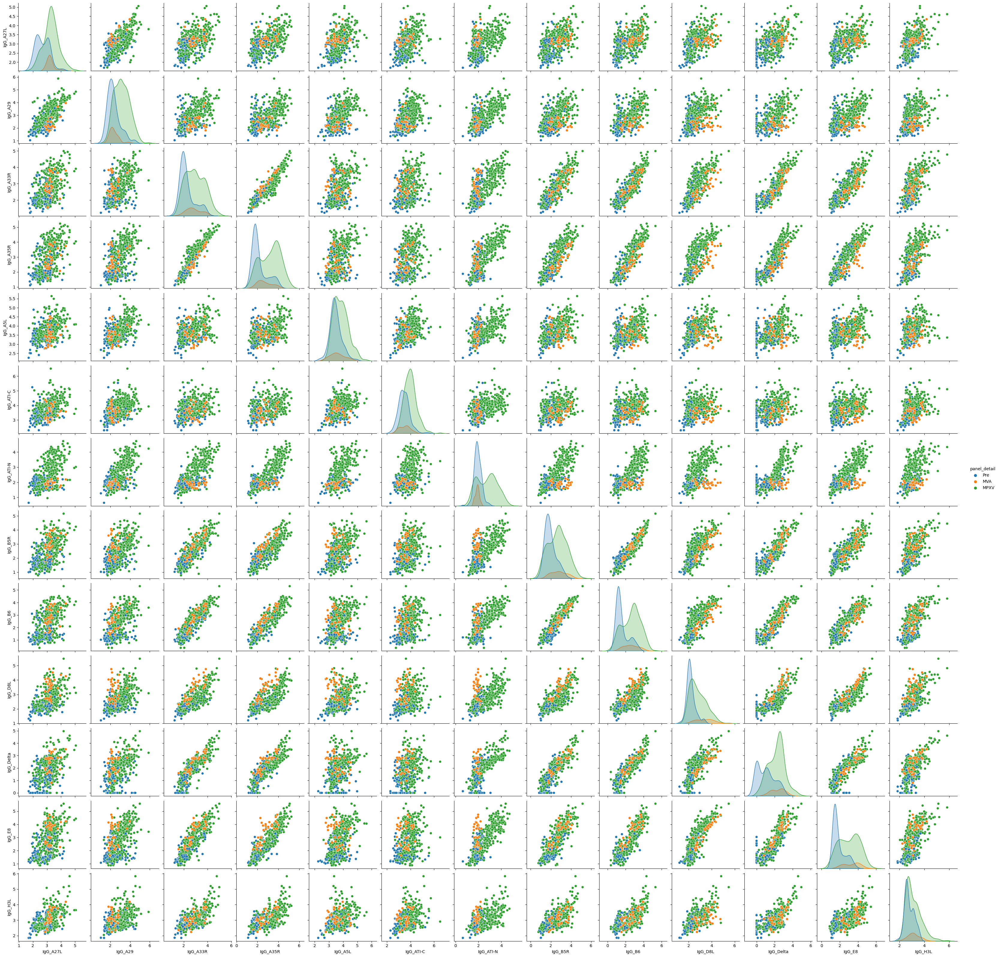

In [66]:
import warnings
warnings.filterwarnings('ignore')
#df_corr = df_igg_all.drop("panel", axis=1)
sns.pairplot(df_acute, hue='panel_detail', hue_order=["Pre", "MVA", "MPXV"])
plt.show()

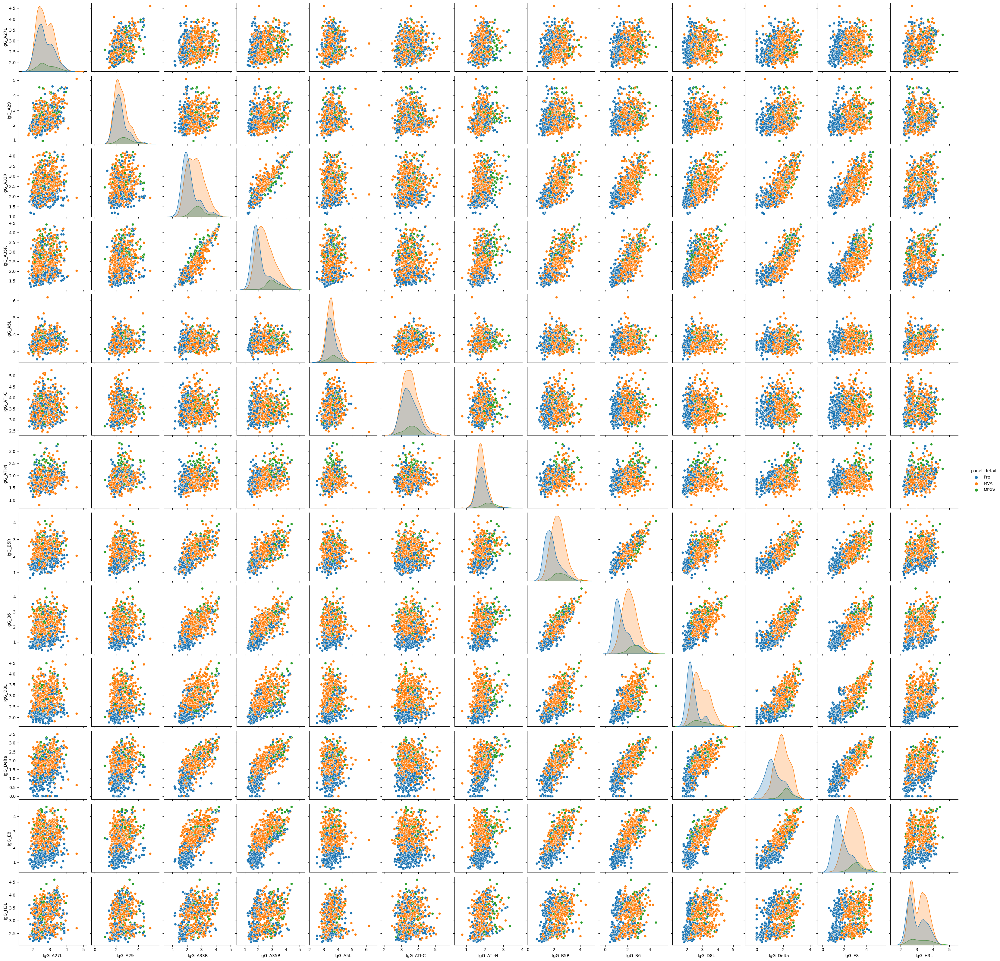

In [67]:
import warnings
warnings.filterwarnings('ignore')
#df_corr = df_igg_all.drop("panel", axis=1)
sns.pairplot(df_epi, hue='panel_detail', hue_order=["Pre", "MVA", "MPXV"])
plt.show()

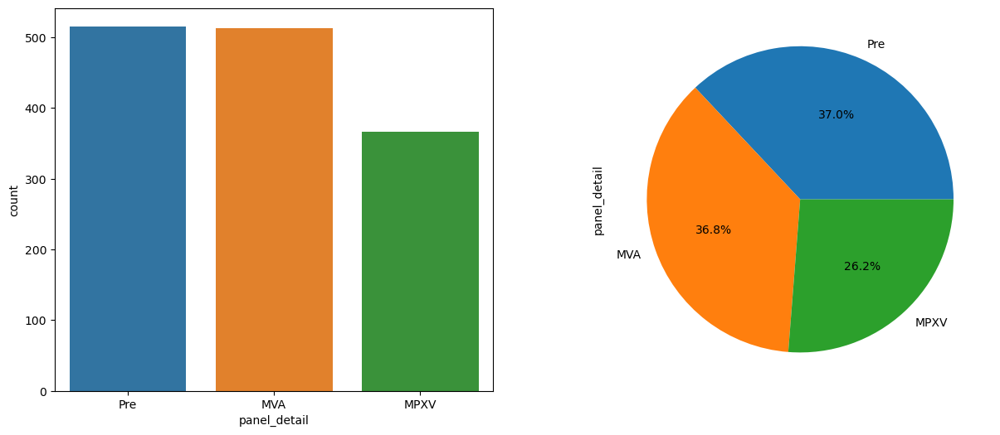

In [94]:
fig, ax=plt.subplots(1,2,figsize=(15,6))
_ = sns.countplot(x='panel_detail', data=df_all, ax=ax[0], order=["Pre", "MVA", "MPXV"])
_ = df_all['panel_detail'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1])

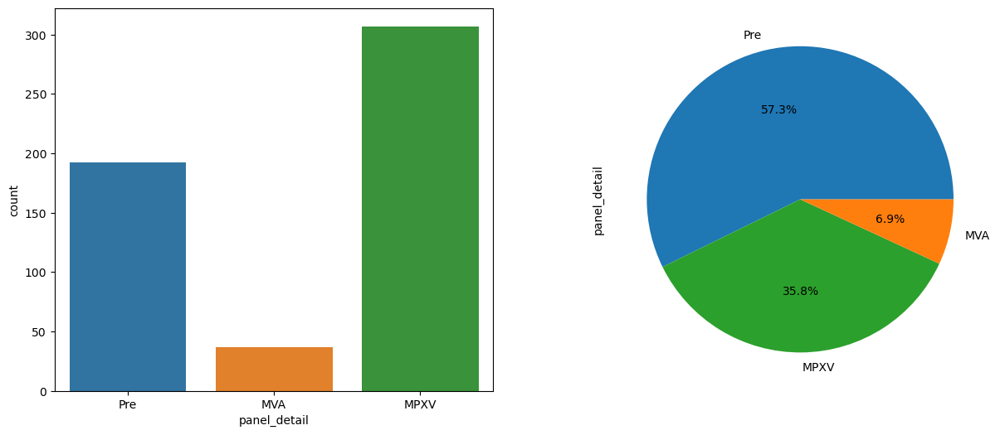

In [106]:
fig, ax=plt.subplots(1,2,figsize=(15,6))
_ = sns.countplot(x='panel_detail', data=df_acute, ax=ax[0],order=["Pre", "MVA", "MPXV"])
_ = df_acute['panel_detail'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1], labels = ["Pre", "MPXV", "MVA"], colors=["C0", "C2", "C1"])

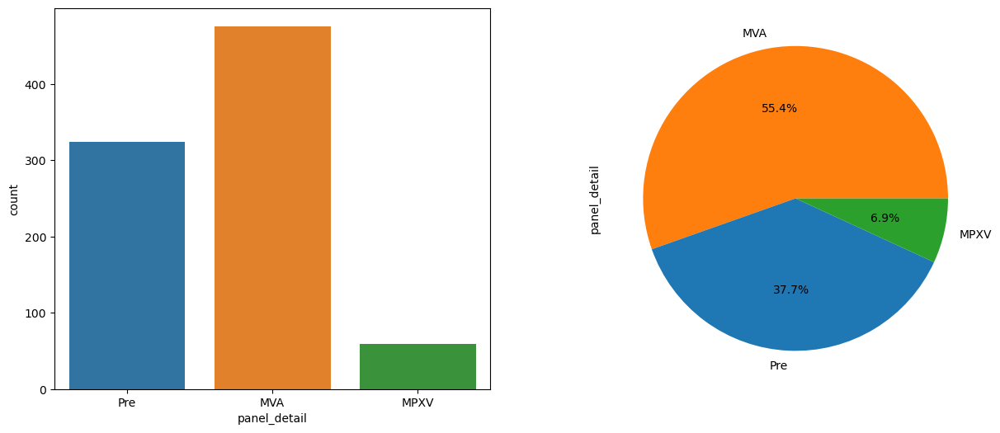

In [111]:
fig, ax=plt.subplots(1,2,figsize=(15,6))
_ = sns.countplot(x='panel_detail', data=df_epi, ax=ax[0], order=["Pre", "MVA", "MPXV"])
_ = df_epi['panel_detail'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1], labels = ["MVA", "Pre", "MPXV"], colors=["C1", "C0", "C2"])

<Axes: xlabel='analyte', ylabel='analyte'>

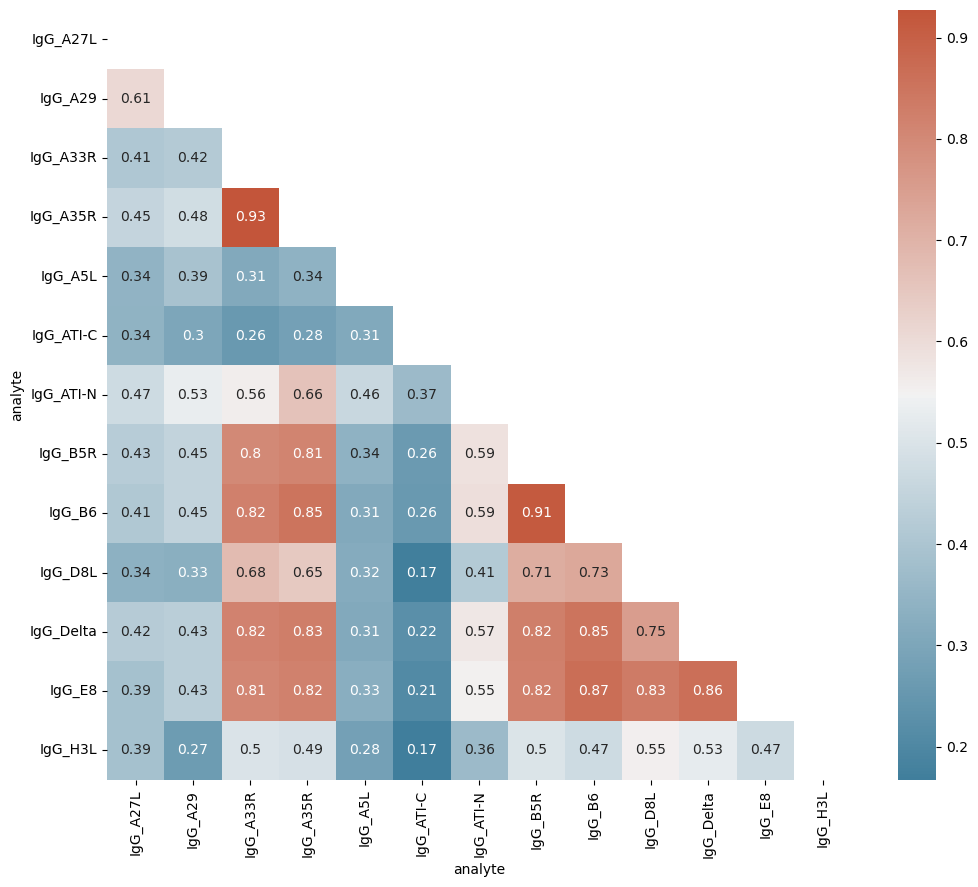

In [62]:
corr = df_all.corr()
#
# Set up the matplotlib plot configuration
#
f, ax = plt.subplots(figsize=(12, 10))
#
# Generate a mask for upper traingle
#
mask = np.triu(np.ones_like(corr, dtype=bool))
#
# Configure a custom diverging colormap
#
cmap = sns.diverging_palette(230, 20, as_cmap=True)
#
# Draw the heatmap
#
sns.heatmap(corr, annot=True, mask = mask, cmap=cmap)

<Axes: xlabel='analyte', ylabel='analyte'>

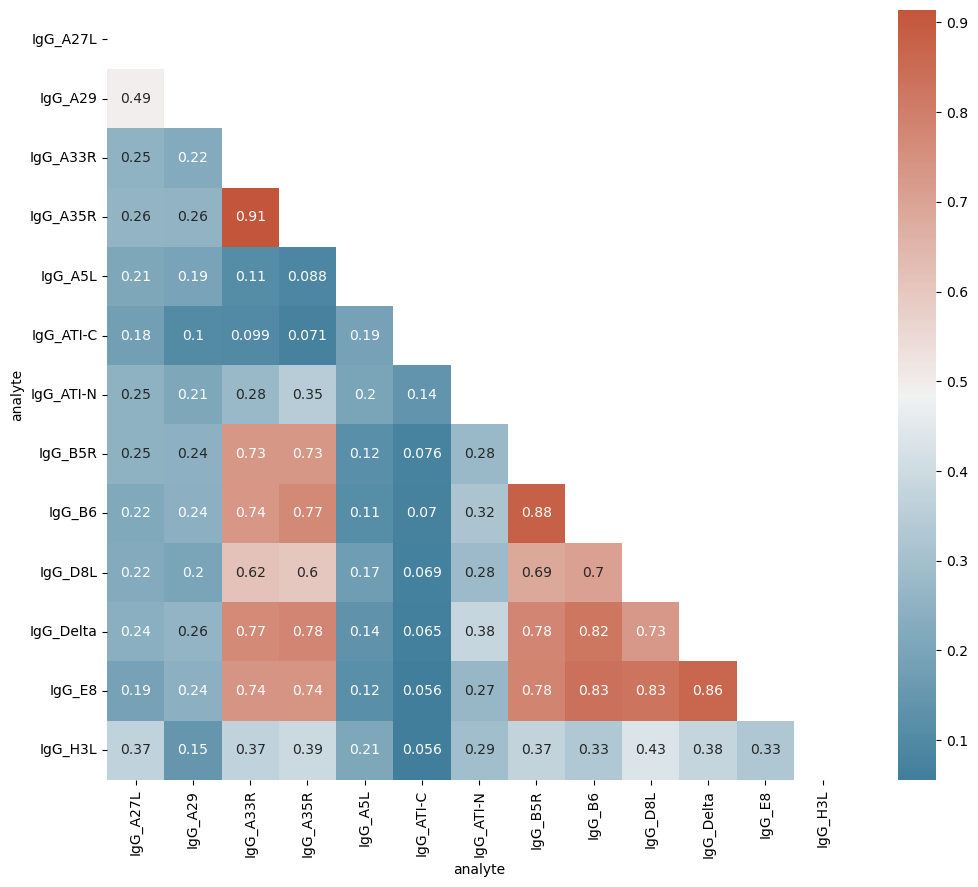

In [63]:
corr = df_epi.corr()
#
# Set up the matplotlib plot configuration
#
f, ax = plt.subplots(figsize=(12, 10))
#
# Generate a mask for upper traingle
#
mask = np.triu(np.ones_like(corr, dtype=bool))
#
# Configure a custom diverging colormap
#
cmap = sns.diverging_palette(230, 20, as_cmap=True)
#
# Draw the heatmap
#
sns.heatmap(corr, annot=True, mask = mask, cmap=cmap)

<Axes: xlabel='analyte', ylabel='analyte'>

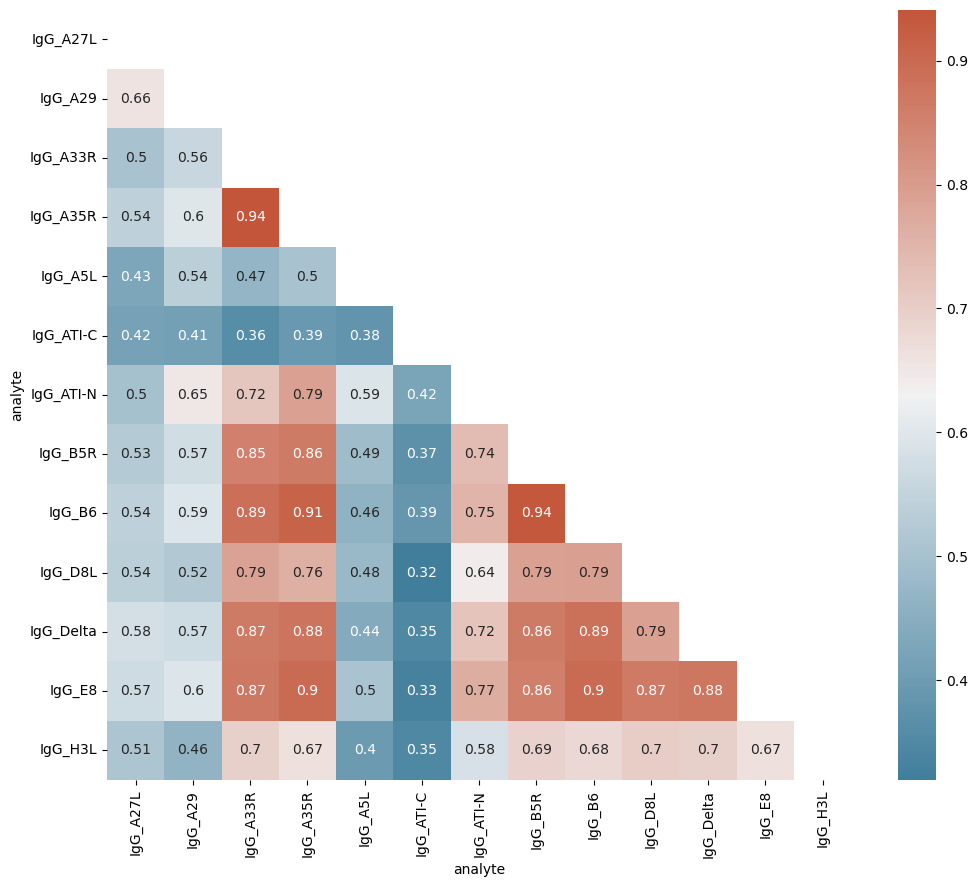

In [64]:
corr = df_acute.corr()
#
# Set up the matplotlib plot configuration
#
f, ax = plt.subplots(figsize=(12, 10))
#
# Generate a mask for upper traingle
#
mask = np.triu(np.ones_like(corr, dtype=bool))
#
# Configure a custom diverging colormap
#
cmap = sns.diverging_palette(230, 20, as_cmap=True)
#
# Draw the heatmap
#
sns.heatmap(corr, annot=True, mask = mask, cmap=cmap)

In [45]:
# change for childhood vax
def group_df_analyte(df, data_column="data"):
    df = df.pivot_table(
        values=data_column,
        # index=["sampleID_metadata", "panel_detail", "panel", "serostatus_delta_IgG"],
        index=["sampleID_metadata", "panel_detail", "panel"],
        columns=["analyte"],
        aggfunc="first",
        dropna=True,
    )

    df = df.dropna()

    df = df.reset_index(level=["panel_detail"])

    return df

In [51]:
def preprocess_data(
    df_in,
    antibody="IgG",
    sero_th="all",
    data_column="data",
    exclude_features=("None"),
):
    """
    Antibody: "IgG", "IgM", "IgM_IgG"
    sero_th: "all", "positive", "borderline positive"
    data_column: "data", "dataln"
    panel: "all", "acute", "epi"
    exclude_features: list of features we would like to exclude for example ["M1", "L1R"]
    """

    # Replace -inf with NaN
    df_in.replace([np.inf, -np.inf], np.nan, inplace=True)

    # Fow now filter antibody values
    if antibody == "IgM_IgG":
        # Filter out IgA or other analytes
        df_in = df_in[df_in["isotype"].isin(["IgM", "IgG"])]
        df_in["analyte"] = df_in["isotype"] + "_" + df_in["analyte"]
    else:
        df_in = df_in[df_in["isotype"] == antibody]
        df_in["analyte"] = df_in["isotype"] + "_" + df_in["analyte"]
    
    
    # Only select necessary columns, for now Analyte(s)
    df_in = df_in[
        [
            "sampleID_metadata",
            "panel_detail",
            "panel",
            "analyte",
            data_column,
            "serostatus_cat.delta",
            "MPX_vac_final",
        ]
    ]

    # Add column for explicit serostatus of delta antigen
    df_in["serostatus_delta_IgG"] = df_in.apply(lambda x: x['serostatus_cat.delta'] if x["analyte"] == "IgG_Delta" else np.nan, axis=1)
    serostatus_IDs = df_in[df_in["serostatus_delta_IgG"].notna()]

    if sero_th == "positive":
        serostatus_IDs = serostatus_IDs[serostatus_IDs["serostatus_delta_IgG"].isin(["positive"])]
    elif sero_th == "borderline positive":
        serostatus_IDs = serostatus_IDs[
            serostatus_IDs["serostatus_delta_IgG"].isin(["borderline positive", "positive"])
        ]
    serostatus_IDs = serostatus_IDs["sampleID_metadata"].unique()



    print(
        f"ATTENTION: Dataframe includes {df_in.panel_detail.isna().sum()} rows with NaN values in panel_detail.\
        These will be excluded from further analysis."
    )



    # Drop NaN
    df_in = df_in[df_in["panel_detail"].notna()]

    

    # Group by patient ID so that we have analytes as columns
    df_out = group_df_analyte(df_in, data_column=data_column)

    # Drop column if in exclude_features
    # need to use endswith so it will work with IgM+IgG data
    # where columns look like this "IgM_M1", "IgG_M1", ..
    cols_to_drop = df_out.columns[df_out.columns.str.endswith(exclude_features)]
    df_out = df_out.drop(cols_to_drop, axis=1, errors="ignore")

    # Convert multi-index to columns
    df_out = df_out.reset_index()
    

    # Filter only for the serostatus of delta IgG
    if not sero_th == "all":
        df_out = df_out[df_out['sampleID_metadata'].isin(serostatus_IDs)]

    # Reset index
    df_out = df_out.set_index(["sampleID_metadata"])


    # drop this again
    # df_out = df_out.drop("serostatus_delta_IgG", axis=1)

    # Remove CPXV for now
    df_out = df_out[df_out["panel_detail"] != "CPXV"]

    # Extract the unknown samples as df_spox
    df_spox = df_out[df_out["panel_detail"] == "SPox"].drop(["panel"], axis=1)
    # extract the repetition panel
    df_rep = df_out[df_out["panel_detail"] == "SPox_Rep"].drop(["panel"], axis=1)
    # Add -rep to ID
    df_rep = df_rep.rename(index=lambda s: s + '-rep')
    # concat them both
    df_spox = pd.concat([df_spox, df_rep])

    
    # Replace Pre_New samples with Pre
    df_out.loc[df_out.panel_detail == "Pre_New", 'panel_detail'] = "Pre"

    # Remove the Spox and Spox_Rep columns
    df_out = df_out[df_out["panel_detail"] != "SPox"]
    df_out = df_out[df_out["panel_detail"] != "SPox_Rep"]
    
    # Split to the three panels and drop the panel column, not needed anymore
    df_all = df_out.drop(["panel"], axis=1)
    df_acute = df_out[df_out["panel"] != "SPox"].drop(["panel"], axis=1)
    df_epi = df_out[df_out["panel"] == "SPox"].drop(["panel"], axis=1)

    return df_all, df_acute, df_epi, df_spox

In [49]:
d = {}
for antibody, sero_status, data_col, exclude_cols in itertools.product(
    antibody_list, sero_list, data_cols_list, exclusion_list
):
    df_all, df_acute, df_epi, df_spox = preprocess_data(
        input_data,
        antibody=antibody,
        sero_th=sero_status,
        data_column=data_col,
        exclude_features=exclude_cols,
    )
    # just for readability when saving files
    exclude_cols = "".join(exclude_cols)
    d[
        f"antibody_{antibody}_serostatus_{sero_status}_datacol_{data_col}_excluding_{exclude_cols}"
    ] = [df_all, df_acute, df_epi, df_spox]

ATTENTION: Dataframe includes 0 rows with NaN values in panel_detail.        These will be excluded from further analysis.
       sampleID_metadata panel_detail     panel    analyte    dataIn  \
0      P-22-00887-001-05         MPXV      MPXV    IgG_A29  3.260276   
1      P-22-00891-001-05         MPXV      MPXV    IgG_A29  3.161486   
2      P-22-00893-001-09         MPXV      MPXV    IgG_A29  3.418797   
3      P-22-00887-001-10         MPXV      MPXV    IgG_A29  3.832305   
4      P-22-00891-001-09         MPXV      MPXV    IgG_A29  3.470279   
...                  ...          ...       ...        ...       ...   
63083          SPox-0738     SPox_Rep  SPox_Rep  IgM_Delta  0.000000   
63084          SPox-0966     SPox_Rep  SPox_Rep  IgM_Delta  1.671148   
63085          SPox-0996     SPox_Rep  SPox_Rep  IgM_Delta  0.305627   
63086          SPox-1063     SPox_Rep  SPox_Rep  IgM_Delta  1.170192   
63087          SPox-1116     SPox_Rep  SPox_Rep  IgM_Delta  1.056822   

      serost

In [31]:
df_all, df_acute, df_epi, df_spox = d['antibody_IgG_serostatus_all_datacol_dataIn_excluding_L1RM1VACV']